# STEP 1:
# Problem Statement

Given the details of cell nuclei taken from breast mass, predict whether or not a patient
has breast cancer using the SVM and Ensembling Techniques. Perform necessary exploratory
data analysis before building the model and evaluate the model based on performance
metrics other than model accuracy.

# STEP 2:
# Data Collection

**1.Importing Necessary Packages...**

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

**2.Importing Dataset...**

In [ ]:
df = pd.read_csv('/content/cancer.csv')
df 

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN


# STEP 3:
# Data Cleaning

**1.Dropping Unnecessary columns..**

In [ ]:
#In this dataset, 'ID' is not a useful feature..
df = df.drop (columns = 'id')
df

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,NaN
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,NaN
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,NaN
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,NaN
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN


**2.Checking for Null values..**

In [ ]:
#Counting null values in each column..
df.isnull().sum()

diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed: 32                569
dtype: i

*All the values in 'Unnamed: 32' are NaN.. So, we are remove that column itself..*

In [ ]:
df = df.drop (columns = 'Unnamed: 32')
df

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


**3.Checking for Datatypes of each column..**

In [ ]:
df.dtypes

#All the Features are in float format.. Except Diagnosis feature..

diagnosis                   object
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst            float64
concave points_worst

*All the features are in correct format..*

**4.Checking for Outliers..**

In [29]:
#To Check for Outliers..
df1 = df.describe()
col1 = df1.columns
#print(df1)

for i in col1:
  # print(i)
  # print(df1[i])
  x = df1[i][6]
  y = df1[i][4]

  IQR = x - y
  U_Threshold = x + (1.5*IQR)
  L_Threshold = y - (1.5*IQR)
  if df1[i][7] > U_Threshold:
    OP_U = sum(df[i]>U_Threshold)
    print(f'There are {OP_U} Outlierpoints at Upper extreme in',i)
    #print('Upper Threshold value in',i,f'is {U_Threshold}')
  else:
    #print('There are no Outlierpoints at Upper extreme in',i)
    pass
  if df1[i][3] < L_Threshold:
    OP_L = sum(df[i]<L_Threshold)
    print(f'There are {OP_L} Outlierpoints at Lower extreme in',i)
    #print('Lower Threshold value in',i,f'is {L_Threshold}')
  else:
    #print('There are no Outlierpoints at Lower extreme in',i)
    pass

There are 14 Outlierpoints at Upper extreme in radius_mean
There are 7 Outlierpoints at Upper extreme in texture_mean
There are 13 Outlierpoints at Upper extreme in perimeter_mean
There are 25 Outlierpoints at Upper extreme in area_mean
There are 5 Outlierpoints at Upper extreme in smoothness_mean
There are 1 Outlierpoints at Lower extreme in smoothness_mean
There are 16 Outlierpoints at Upper extreme in compactness_mean
There are 18 Outlierpoints at Upper extreme in concavity_mean
There are 10 Outlierpoints at Upper extreme in concave points_mean
There are 14 Outlierpoints at Upper extreme in symmetry_mean
There are 1 Outlierpoints at Lower extreme in symmetry_mean
There are 15 Outlierpoints at Upper extreme in fractal_dimension_mean
There are 38 Outlierpoints at Upper extreme in radius_se
There are 20 Outlierpoints at Upper extreme in texture_se
There are 38 Outlierpoints at Upper extreme in perimeter_se
There are 65 Outlierpoints at Upper extreme in area_se
There are 30 Outlierpoint

*Here, the Outlier points are real datapoints, because that only indicates the Presence of cancer or not.. So, we should not correct these points.*

**5.Checking for Duplicates..**

In [ ]:
df.shape

(569, 31)

In [ ]:
df = df.drop_duplicates().reset_index(drop=True)
df.shape

(569, 31)

*There is no duplicates in dataset.*

# STEP 4:
# Exploratory Data Analysis

**1.Checking for Distribution of Each features..**

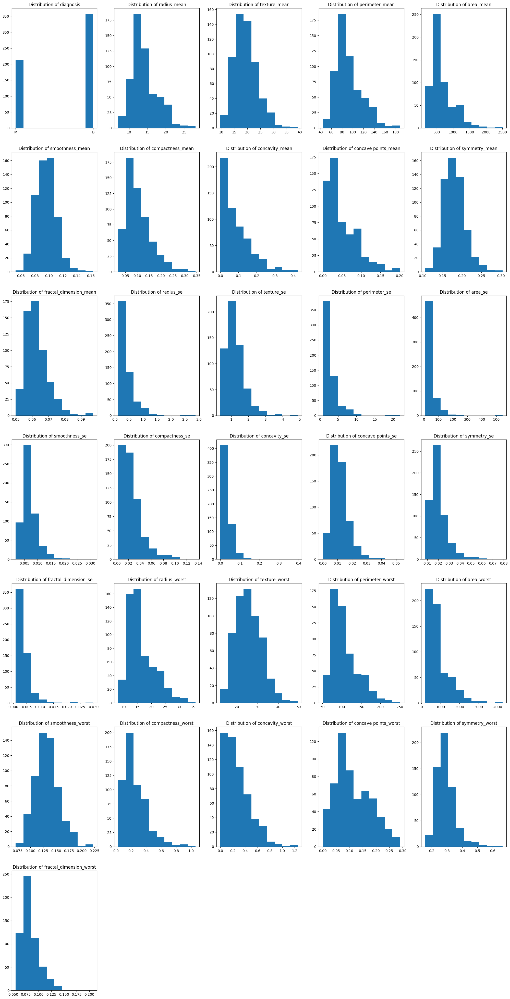

In [ ]:
plt.figure(figsize = (25,50))
for i in range(1,(len(df.columns)+1)):
  plt.subplot(7,5,i)
  plt.hist(df[df.columns[i-1]])
  plt.title(f'Distribution of {df.columns[i-1]}')

From the distribution plot, Datapoints belongs to 'B' class is 63% and 'M' class is 37%..

**2.Checking relationship between Feature vs Feature..**

In [ ]:
sns.pairplot(df, hue='diagnosis')

*From the above different plots, In Majority of the feature combination we can able to separate the 'M' and 'B' classes linearly..*

**3. To find value ranges of 'M' and 'B' classes..**

In [ ]:
x = df[['radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst']].groupby(df['diagnosis'])

In [ ]:
fts_mean = x.mean()
fts_mean

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
diagnosis,,,,,,,,,,,,,,,,,,,,,
B,12.146524,17.914762,78.075406,462.790196,0.092478,0.080085,0.046058,0.025717,0.174186,0.062867,...,13.379801,23.515070,87.005938,558.899440,0.124959,0.182673,0.166238,0.074444,0.270246,0.079442
M,17.462830,21.604906,115.365377,978.376415,0.102898,0.145188,0.160775,0.087990,0.192909,0.062680,...,21.134811,29.318208,141.370330,1422.286321,0.144845,0.374824,0.450606,0.182237,0.323468,0.091530


<bound method _AxesBase.set_yticklabels of <Axes: >>

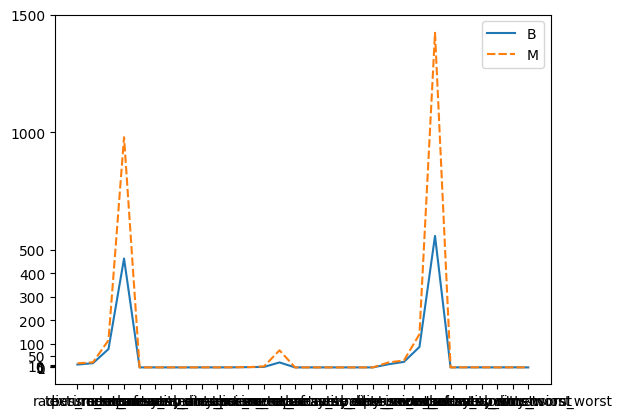

In [ ]:
ax = sns.lineplot(data = [fts_mean.iloc[0], fts_mean.iloc[1]])
ax.set_yticks([0.1,1,5,10,50,100,200,300,400,500,1000,1500])
ax.set_yticklabels

*From the mean values of all the features, we can clearly see for 'M' classes the values are high when compared with 'B' class..*

# STEP 5:
# Data Preprocessing

**1.Encoding..**

In [ ]:
#'diagnosis' column having Binary Categorical values.. I'm going to do Label Encoding on that columns..
#Here, we are going to predict Cancer, ie 'M' class.. So, 'M' class will be taken as label 1..

df['diagnosis'] = df['diagnosis'].map({'B':0, 'M':1})
df

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,1,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,1,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,1,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,1,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


**2.Split...**

In [ ]:
# Array of feature..
X = df.drop(columns = 'diagnosis').values

# Array of Target..
y = df['diagnosis'].values

#Splitting the dataset..
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state=2580)

**3.Scaling..**

*In SVM, it is necessary to do Scaling.. Because we are using Distance metric here..*

In [ ]:

#Importing..
from sklearn.preprocessing import StandardScaler

#Initialising the scaler.. MAking Instance
scaler = StandardScaler()

#Fitting the Features Training data.. And finding mean, std..
scaler.fit(X_train)

#Transforming or scaling the Feature training data with Mean and std of Feature Training data..
X_train_scaled = scaler.transform(X_train)

#Transforming or scaling the Feature test data with Mean and std of Feature Training data..
X_test_scaled = scaler.transform(X_test)

# STEP 6:
# Building ML Model

### 1.Building SVM Model

Fitting SVM model.. For Random 'C' value..

In [27]:
#Fitting Model...
from sklearn.svm import SVC
SVM = SVC(kernel = 'linear', C = 0.01)
SVM.fit(X_train_scaled, y_train)

#I'm using Linear kernel.. Because relationship between features are linearly separable..

SVC(C=0.01, kernel='linear')

In [ ]:
#Prediction..
y_pred = SVM.predict(X_test_scaled)
y_pred

array([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0,
       1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0,
       1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1])

In [ ]:
#Score..
SVM.score(X_test_scaled, y_test)

0.965034965034965

*Inorder to avoid Underfitting and Overfitting of Model, We have to find a best Regularization parameter 'C' value, using Cross Validation Score..*

Finding best value of 'C'..

In [28]:
from sklearn.model_selection import cross_val_score
C = np.arange(0.1,1,0.1)
comp_Cvalues = []
for i in C:
  SVM_C = SVC(kernel = 'linear', C = i)
  SVM_C.fit(X_train_scaled, y_train)
  Train_acc = SVM_C.score(X_train_scaled, y_train)
  CV_Score = np.mean(cross_val_score(SVM_C, X_train_scaled, y_train, cv=10))
  print(f'C = {i}, Train_acc = {Train_acc}, CV-Score = {CV_Score}')
  comp_Cvalues.append([i,Train_acc,CV_Score])

print(comp_Cvalues)

temp6 = []
for i in comp_Cvalues:
  temp6.append(i[2])
#print(temp6)

best_C_value_comb = comp_Cvalues[temp6.index(max(temp6))]
print(f'Best C value is, {best_C_value_comb}')
best_C_value = comp_Cvalues[temp6.index(max(temp6))][0]

C = 0.1, Train_acc = 0.9835680751173709, CV-Score = 0.9764673311184939
C = 0.2, Train_acc = 0.9859154929577465, CV-Score = 0.9787929125138428
C = 0.30000000000000004, Train_acc = 0.9859154929577465, CV-Score = 0.9834440753045405
C = 0.4, Train_acc = 0.9859154929577465, CV-Score = 0.9834440753045405
C = 0.5, Train_acc = 0.9882629107981221, CV-Score = 0.9763565891472868
C = 0.6, Train_acc = 0.9882629107981221, CV-Score = 0.9763565891472868
C = 0.7000000000000001, Train_acc = 0.9882629107981221, CV-Score = 0.9763565891472868
C = 0.8, Train_acc = 0.9882629107981221, CV-Score = 0.9786821705426357
C = 0.9, Train_acc = 0.9882629107981221, CV-Score = 0.9763565891472868
[[0.1, 0.9835680751173709, 0.9764673311184939], [0.2, 0.9859154929577465, 0.9787929125138428], [0.30000000000000004, 0.9859154929577465, 0.9834440753045405], [0.4, 0.9859154929577465, 0.9834440753045405], [0.5, 0.9882629107981221, 0.9763565891472868], [0.6, 0.9882629107981221, 0.9763565891472868], [0.7000000000000001, 0.98826291

Fitting SVM model for best 'C' value...

In [ ]:
#Fitting Model...
from sklearn.svm import SVC
SVM_best = SVC(kernel = 'linear', C = best_C_value, probability = True)
SVM_best.fit(X_train_scaled, y_train)

SVC(C=0.30000000000000004, kernel='linear', probability=True)

In [ ]:
#Prediction..
y_pred_SVM = SVM_best.predict(X_test_scaled)
y_pred_SVM

array([1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0,
       1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0,
       1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1])

## **Building Ensemble ML models**

### 2.Building Random Forest model..

In [ ]:
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(n_estimators = 100, max_depth = 5, max_features = 'sqrt', random_state= 2580)
RF.fit(X_train_scaled, y_train)

RandomForestClassifier(max_depth=5, random_state=2580)

In [ ]:
#Prediction..
y_pred_RF = RF.predict(X_test_scaled)
y_pred_RF

array([1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0,
       1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0,
       1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1])

### 3.Building XGBoost model..

To run the XGBoost model, we have to find the best learning rate (lambda) value..

In [ ]:
import xgboost as xgb
#lr_values = [0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]
lr_values = np.arange(0.1,1,0.1)
comp_lr_values = []
for learn_rate in lr_values:
  XGB_lr = xgb.XGBClassifier(learning_rate = learn_rate, n_estimators = 100, verbosity = 0)
  XGB_lr.fit(X_train_scaled,y_train)

  Train_acc_lr = XGB_lr.score(X_train_scaled, y_train)
  CV_Score = np.mean(cross_val_score(XGB_lr, X_train_scaled, y_train, cv=10))
  print(f'Learningr_rate = {learn_rate}, Train_acc = {Train_acc}, CV-Score = {CV_Score}')
  comp_lr_values.append([learn_rate,Train_acc,CV_Score])

print(comp_lr_values)

temp7 = []
for i in comp_lr_values:
  temp7.append(i[2])
print(temp7)

print(f'Best Learnign_rate value is, {comp_lr_values[temp7.index(max(temp7))]}')
best_learn_rate = comp_lr_values[temp7.index(max(temp7))][0]

Learningr_rate = 0.1, Train_acc = 0.9953051643192489, CV-Score = 0.9672203765227021
Learningr_rate = 0.2, Train_acc = 0.9953051643192489, CV-Score = 0.9718715393133998
Learningr_rate = 0.30000000000000004, Train_acc = 0.9953051643192489, CV-Score = 0.9718715393133998
Learningr_rate = 0.4, Train_acc = 0.9953051643192489, CV-Score = 0.967109634551495
Learningr_rate = 0.5, Train_acc = 0.9953051643192489, CV-Score = 0.9717607973421927
Learningr_rate = 0.6, Train_acc = 0.9953051643192489, CV-Score = 0.9647286821705426
Learningr_rate = 0.7000000000000001, Train_acc = 0.9953051643192489, CV-Score = 0.9694905869324474
Learningr_rate = 0.8, Train_acc = 0.9953051643192489, CV-Score = 0.9718161683277963
Learningr_rate = 0.9, Train_acc = 0.9953051643192489, CV-Score = 0.9718161683277963
[[0.1, 0.9953051643192489, 0.9672203765227021], [0.2, 0.9953051643192489, 0.9718715393133998], [0.30000000000000004, 0.9953051643192489, 0.9718715393133998], [0.4, 0.9953051643192489, 0.967109634551495], [0.5, 0.99

In [ ]:
XGB_best = xgb.XGBClassifier(learning_rate = best_learn_rate, n_estimators = 100)
XGB_best.fit(X_train_scaled, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [ ]:
y_pred_XGB = XGB_best.predict(X_test_scaled)
y_pred_XGB

array([1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0,
       1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0,
       1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1])

# STEP 7:
# Validation of Model

### 1.Validating SVM Model (For best 'C' value)

Importing Validation packages..

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, roc_auc_score
from sklearn.metrics import classification_report

Finding Confusion matrix..

In [ ]:
conf_matrix_SVM = confusion_matrix(y_test,y_pred_SVM)
print(conf_matrix_SVM)

[[81  2]
 [ 2 58]]


*From the Confusion matrix, The SVM model founds 4 prediction wrong out of 143 predictions..*

Validating the Model, using Accuracy metric..

In [ ]:
print(f'Accuracy: {accuracy_score(y_test, y_pred_SVM)}')

Accuracy: 0.972027972027972


Validating the Model, using F1-Score metric..

In [ ]:
print(f'F1-Score: {f1_score(y_test,y_pred_SVM)}')

F1-Score: 0.9666666666666667


Validating the Model, using AUROC metric..

In [ ]:
print(f'AUROC Score: {roc_auc_score(y_test, y_pred_SVM)}')

AUROC Score: 0.9712851405622491


Classification report - SVM Model

In [ ]:
print('Classification Report for SVM Model is,')
print(classification_report(y_test, y_pred_SVM))

#Specificity,
specifi_SVM = conf_matrix_SVM[1,1] / (conf_matrix_SVM[1,1]+conf_matrix_SVM[0,1])
print(f'Specificity: {specifi_SVM}')

#Sensitivity,
sensiti_SVM = conf_matrix_SVM[0,0] / (conf_matrix_SVM[0,0]+conf_matrix_SVM[1,0])
print(f'Sensitivity: {sensiti_SVM}')

Classification Report for SVM Model is,
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        83
           1       0.97      0.97      0.97        60

    accuracy                           0.97       143
   macro avg       0.97      0.97      0.97       143
weighted avg       0.97      0.97      0.97       143

Specificity: 0.9666666666666667
Sensitivity: 0.9759036144578314


*From Specificity, 96.7% of people without Cancer were correctly identified by this SVM Model..
From Sensitivity, 97.5% of people With Cancer were correctly identified by this SVM Model..*

***The AUROC Score for SVM model is, 97.1%***

### 2.Validating Random Forest model

Finding Confusion matrix..

In [ ]:
conf_matrix_RF = confusion_matrix(y_test,y_pred_RF)
print(conf_matrix_RF)

[[82  1]
 [ 4 56]]


*From the Confusion matrix, The Random Forest model founds 5 prediction wrong out of 143 predictions..*

Validating the Model, using Accuracy metric..

In [ ]:
print(f'Accuracy: {accuracy_score(y_test, y_pred_RF)}')

Accuracy: 0.965034965034965


Validating the Model, using F1-Score metric..

In [ ]:
print(f'F1-Score: {f1_score(y_test,y_pred_RF)}')

F1-Score: 0.9572649572649572


Validating the Model, using AUROC metric..

In [ ]:
print(f'AUROC Score: {roc_auc_score(y_test, y_pred_RF)}')

AUROC Score: 0.9606425702811245


In [ ]:
print('Classification Report for Random Forest Model is,')
print(classification_report(y_test, y_pred_RF))

#Specificity,
specifi_RF = conf_matrix_RF[1,1] / (conf_matrix_RF[1,1]+conf_matrix_RF[0,1])
print(f'Specificity: {specifi_RF}')

#Sensitivity,
sensiti_RF = conf_matrix_RF[0,0] / (conf_matrix_RF[0,0]+conf_matrix_RF[1,0])
print(f'Sensitivity: {sensiti_RF}')

Classification Report for Random Forest Model is,
              precision    recall  f1-score   support

           0       0.95      0.99      0.97        83
           1       0.98      0.93      0.96        60

    accuracy                           0.97       143
   macro avg       0.97      0.96      0.96       143
weighted avg       0.97      0.97      0.96       143

Specificity: 0.9824561403508771
Sensitivity: 0.9534883720930233


*From Specificity, 98.2% of people without Cancer were correctly identified by this Random Forest Model..
From Sensitivity, 95.3% of people With Cancer were correctly identified by this Random Forest Model..*

***The AUROC Score for Random Forest model is, 96%***

### 3.Validating XGBoost model

Finding Confusion matrix..

In [ ]:
conf_matrix_XGB = confusion_matrix(y_test,y_pred_XGB)
print(conf_matrix_XGB)

[[82  1]
 [ 4 56]]


*From the Confusion matrix, The XGBoost model founds 6 prediction wrong out of 143 predictions..*

Validating the Model, using Accuracy metric..

In [ ]:
print(f'Accuracy: {accuracy_score(y_test, y_pred_XGB)}')

Accuracy: 0.965034965034965


Validating the Model, using F1-Score metric..

In [ ]:
print(f'F1-Score: {f1_score(y_test,y_pred_XGB)}')

F1-Score: 0.9572649572649572


Validating the Model, using AUROC metric..

In [ ]:
print(f'AUROC Score: {roc_auc_score(y_test, y_pred_XGB)}')

AUROC Score: 0.9606425702811245


In [ ]:
print('Classification Report for XGBoost Model is,')
print(classification_report(y_test, y_pred_XGB))

#Specificity,
specifi_XGB = conf_matrix_XGB[1,1] / (conf_matrix_XGB[1,1]+conf_matrix_XGB[0,1])
print(f'Specificity: {specifi_XGB}')

#Sensitivity,
sensiti_XGB = conf_matrix_XGB[0,0] / (conf_matrix_XGB[0,0]+conf_matrix_XGB[1,0])
print(f'Sensitivity: {sensiti_XGB}')

Classification Report for XGBoost Model is,
              precision    recall  f1-score   support

           0       0.95      0.99      0.97        83
           1       0.98      0.93      0.96        60

    accuracy                           0.97       143
   macro avg       0.97      0.96      0.96       143
weighted avg       0.97      0.97      0.96       143

Specificity: 0.9824561403508771
Sensitivity: 0.9534883720930233


*From Specificity, 98.2% of people without Cancer were correctly identified by this XGBoost Model..
From Sensitivity, 95.3% of people With Cancer were correctly identified by this XGBoost Model..*

***The AUROC Score for XGBoost model is, 96%***

### ***Therefore, From all the 3 models (SVM, Random Forest, XGBoost), SVM Model giving better AUROC of 97.1%...***